# LendingClub Loan Extension Analysis

In [228]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')

from sklearn.preprocessing import StandardScaler

<h4> 1. Preparing dataset for preprocessing </h4>

In [229]:
data = pd.read_csv('data/loan.csv', low_memory=False)

In [230]:
data.shape

(887379, 74)

In [231]:
data.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m
0,1077501,1296599,5000.0,5000.0,4975.0,36 months,10.65,162.87,B,B2,NaN,10+ years,RENT,24000.0,Verified,Dec-2011,Fully Paid,n,https://www.lendingclub.com/browse/loanDetail....,Borrower added on 12/22/11 > I need to upgra...,credit_card,Computer,860xx,AZ,27.65,0.0,Jan-1985,1.0,NaN,NaN,3.0,0.0,13648.0,83.7,9.0,f,0.0,0.0,5861.071414,5831.78,5000.00,861.07,0.00,0.00,0.00,Jan-2015,171.62,NaN,Jan-2016,0.0,NaN,1.0,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1077430,1314167,2500.0,2500.0,2500.0,60 months,15.27,59.83,C,C4,Ryder,< 1 year,RENT,30000.0,Source Verified,Dec-2011,Charged Off,n,https://www.lendingclub.com/browse/loanDetail....,Borrower added on 12/22/11 > I plan to use t...,car,bike,309xx,GA,1.00,0.0,Apr-1999,5.0,NaN,NaN,3.0,0.0,1687.0,9.4,4.0,f,0.0,0.0,1008.710000,1008.71,456.46,435.17,0.00,117.08,1.11,Apr-2013,119.66,NaN,Sep-2013,0.0,NaN,1.0,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1077175,1313524,2400.0,2400.0,2400.0,36 months,15.96,84.33,C,C5,NaN,10+ years,RENT,12252.0,Not Verified,Dec-2011,Fully Paid,n,https://www.lendingclub.com/browse/loanDetail....,NaN,small_business,real estate business,606xx,IL,8.72,0.0,Nov-2001,2.0,NaN,NaN,2.0,0.0,2956.0,98.5,10.0,f,0.0,0.0,3003.653644,3003.65,2400.00,603.65,0.00,0.00,0.00,Jun-2014,649.91,NaN,Jan-2016,0.0,NaN,1.0,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1076863,1277178,10000.0,10000.0,10000.0,36 months,13.49,339.31,C,C1,AIR RESOURCES BOARD,10+ years,RENT,49200.0,Source Verified,Dec-2011,Fully Paid,n,https://www.lendingclub.com/browse/loanDetail....,Borrower added on 12/21/11 > to pay for prop...,other,personel,917xx,CA,20.00,0.0,Feb-1996,1.0,35.0,NaN,10.0,0.0,5598.0,21.0,37.0,f,0.0,0.0,12226.302212,12226.30,10000.00,2209.33,16.97,0.00,0.00,Jan-2015,357.48,NaN,Jan-2015,0.0,NaN,1.0,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1075358,1311748,3000.0,3000.0,3000.0,60 months,12.69,67.79,B,B5,University Medical Group,1 year,RENT,80000.0,Source Verified,Dec-2011,Current,n,https://www.lendingclub.com/browse/loanDetail....,Borrower added on 12/21/11 > I plan on combi...,other,Personal,972xx,OR,17.94,0.0,Jan-1996,0.0,38.0,NaN,15.0,0.0,27783.0,53.9,38.0,f,766.9,766.9,3242.170000,3242.17,2233.10,1009.07,0.00,0.00,0.00,Jan-2016,67.79,Feb-2016,Jan-2016,0.0,NaN,1.0,INDIVIDUAL,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [232]:
pd.value_counts(data.loan_status).to_frame()

,loan_status
Current,601779
Fully Paid,207723
Charged Off,45248
Late (31-120 days),11591
Issued,8460
In Grace Period,6253
Late (16-30 days),2357
Does not meet the credit policy. Status:Fully Paid,1988
Default,1219
Does not meet the credit policy. Status:Charged Off,761


In [233]:
data = data.loc[data['loan_status'].isin(['Fully Paid', 'Charged Off'])]
data.shape

(252971, 74)

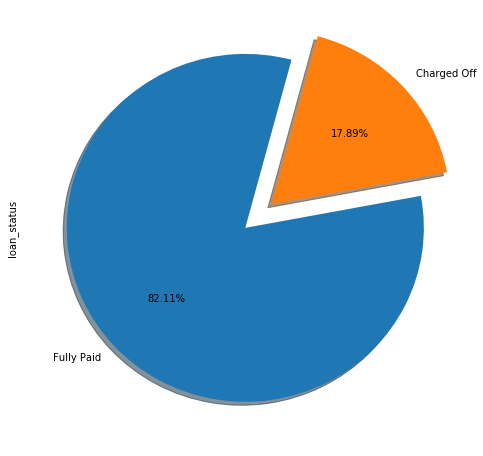

In [234]:
plt.figure(figsize=(8,8))
pd.value_counts(data.loan_status).plot.pie(explode = [0, 0.2], autopct='%1.2f%%', shadow = True, startangle = 75)

In [235]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 252971 entries, 0 to 887371
Data columns (total 74 columns):
id                             252971 non-null int64
member_id                      252971 non-null int64
loan_amnt                      252971 non-null float64
funded_amnt                    252971 non-null float64
funded_amnt_inv                252971 non-null float64
term                           252971 non-null object
int_rate                       252971 non-null float64
installment                    252971 non-null float64
grade                          252971 non-null object
sub_grade                      252971 non-null object
emp_title                      239040 non-null object
emp_length                     243074 non-null object
home_ownership                 252971 non-null object
annual_inc                     252971 non-null float64
verification_status            252971 non-null object
issue_d                        252971 non-null object
loan_status          

<h4> 2. Reviewing variables - drop and edit </h4>

Review each non-numerical variable to either edit or drop it

<h4><b> Term </b></h4>

In [40]:
pd.value_counts(data.term).to_frame()

,term
36 months,445779
60 months,223429


In [41]:
# Change term variable to numerical variable
term={' 36 months':36, ' 60 months':60}
data.term.replace(term, inplace=True)

<h4><b> Grade and Sub-Grade</b></h4>
Following two variables are dedicated to credit rating of each individual. Will change them to numerical while making sure that the hierarchy is taken into account. Lowest number will mean best grade/subgrade.

In [42]:
pd.value_counts(data.grade).to_frame()

,grade
C,190229
B,185191
D,107843
A,106985
E,56806
F,17972
G,4182


In [43]:
grade = data.grade.unique()
grade.sort()
grade

array(['A', 'B', 'C', 'D', 'E', 'F', 'G'], dtype=object)

In [44]:
for x, e in enumerate(grade):
    data.grade.replace(to_replace=e, value=x, inplace=True)
data.grade.unique()

array([2, 1, 5, 3, 0, 4, 6])

In [45]:
pd.value_counts(data.sub_grade).to_frame()

,sub_grade
B4,40432
C1,40223
B3,39907
C2,39809
C3,39358
C4,38769
B5,36033
B2,35209
B1,33610
A5,33363


In [46]:
sub_grade = data.sub_grade.unique()
sub_grade.sort()
sub_grade

array(['A1', 'A2', 'A3', 'A4', 'A5', 'B1', 'B2', 'B3', 'B4', 'B5', 'C1',
       'C2', 'C3', 'C4', 'C5', 'D1', 'D2', 'D3', 'D4', 'D5', 'E1', 'E2',
       'E3', 'E4', 'E5', 'F1', 'F2', 'F3', 'F4', 'F5', 'G1', 'G2', 'G3',
       'G4', 'G5'], dtype=object)

In [47]:
for x, e in enumerate(sub_grade):
    data.sub_grade.replace(to_replace=e, value=x, inplace=True)
data.sub_grade.unique()

array([13,  9, 14, 26, 10,  6,  8,  7, 11, 16,  4,  5, 23, 17, 28, 18, 19,
        1, 12,  2, 25, 15,  3, 24, 20, 21, 22, 32, 31, 30, 27, 29,  0, 33,
       34])

<h4><b> Employee Title and Length </b></h4>
Following two variables describe title and length of employment. Title has 212 thousand categories so it will be dropped. Lenghth of employment should be sufficient to show whether an individual has a stable job.

In [48]:
_ = pd.value_counts(data.emp_title).to_frame() # more than 200 thousand employee categories, hence will be DROPPED

,emp_title
Teacher,11667
Manager,9531
Owner,4928
Registered Nurse,4779
RN,4600
Supervisor,4238
Sales,3635
Project Manager,3366
Driver,3130
Office Manager,3002


In [49]:
pd.value_counts(data.emp_length).to_frame()

,emp_length
10+ years,224690
2 years,58373
< 1 year,52437
3 years,52304
1 year,42398
5 years,40216
4 years,38469
8 years,33757
7 years,32778
6 years,30470


In [50]:
emp_len = {'n/a' : 0, 
           '< 1 year' : 1, 
           '1 year' : 2,
           '2 years' : 3, 
           '3 years' : 4,
           '4 years' : 5,
           '5 years' : 6,
           '6 years' : 7,
           '7 years' : 8,
           '8 years' : 9,
           '9 years' : 10,
           '10+ years' : 11}
data.emp_length.replace(emp_len, inplace=True)
data.emp_length = data.emp_length.replace(np.nan, 0)
data.emp_length.unique()

array([ 1.,  2.,  9.,  5.,  4., 11., 10.,  3.,  8.,  7.,  6.,  0.])

<h4><b> Home ownership </b></h4>
Home ownership variable should be informative for model as individuals who own their home should be much safer clients that ones that only rent it.

In [51]:
pd.value_counts(data.home_ownership).to_frame()

,home_ownership
MORTGAGE,333463
RENT,267358
OWN,68334
OTHER,41
NONE,10
ANY,2


<h4><b> Verification Status </b></h4>
Verification status variable indicated whether the source of income of a client was verified.

In [52]:
pd.value_counts(data.verification_status).to_frame()

,verification_status
Source Verified,266243
Verified,214171
Not Verified,188794


<h4><b> Issued Date </b></h4>
Can be transformed to date time

In [53]:
data.issue_d = pd.to_datetime(data.issue_d)

<h4><b> Payment Plan </b></h4>
Payment plan variable will be dropped as it has only 3 'y' values

In [54]:
pd.value_counts(data.pymnt_plan).to_frame()

,pymnt_plan
n,669200
y,8


<h4><b> Title and Purpose </b></h4>
There are two columns that describe a reason for the loan - title and purpose. As shown below title has many more categories which makes it less specific and helpful for the model, so it will be dropped.

In [55]:
_ = pd.value_counts(data.title).to_frame()

,title
Debt consolidation,350657
Credit card refinancing,143210
Home improvement,33945
Other,26674
Major purchase,10056
Debt Consolidation,6484
Medical expenses,5508
Business,5392
Car financing,4640
Moving and relocation,3260


In [56]:
pd.value_counts(data.purpose).to_frame()

,purpose
debt_consolidation,397847
credit_card,161590
home_improvement,38533
other,30770
major_purchase,11602
small_business,6801
medical,6128
car,5533
moving,3728
vacation,3348


<h4><b> Zip Code </b></h4>
Zip code information is to specific, there are 930 individual values, and there is no sense to make it more general as cutting it to two digits as this will only describe state, which is done by the next variable. Zip code will be dropped.

In [57]:
_ = pd.value_counts(data.zip_code).to_frame()

<h4><b> State Address </b></h4>

In [58]:
_ = pd.value_counts(data.addr_state).to_frame()

<h4><b> Earliest Credit Line </b></h4>

In [59]:
earliest_cr_line = pd.to_datetime(data.earliest_cr_line)
data.earliest_cr_line = earliest_cr_line.dt.year

<h4><b> Initial List Status </b></h4>
Next variable is initial listing status of the loan. Possible values are – W, F and will be changed to binary

In [60]:
pd.value_counts(data.initial_list_status).to_frame()

,initial_list_status
w,364314
f,304894


In [61]:
int_status = {'w':0, 'f':1}
data.initial_list_status.replace(int_status, inplace=True)

<h4><b> Last Payment Date, Next Payment Date and Last Credit Pull Date </b></h4>

In [62]:
data.last_pymnt_d = pd.to_datetime(data.last_pymnt_d)
data.next_pymnt_d = pd.to_datetime(data.next_pymnt_d)
data.last_credit_pull_d = pd.to_datetime(data.last_credit_pull_d)

<h4><b> Policy Code </b></h4>
Policy code has only 1 value so will be dropped.

In [63]:
pd.value_counts(data.policy_code).to_frame()

,policy_code
1.0,669208


<h4><b> Application Type </b></h4>
Application type variable shows whether the loan is individual or joint - number of joint loans will reflect huge number of NaN values in other variables dedicated for these loans. Will change this variable to binary.

In [64]:
pd.value_counts(data.application_type).to_frame()

,application_type
INDIVIDUAL,668762
JOINT,446


In [65]:
app_type={'INDIVIDUAL':0, 'JOINT':1}
data.application_type.replace(app_type, inplace=True)

<h4><b> Recoveries </b></h4>
Recoveries variable informs about post charge off gross recovery. Will transform this to binary that will show whether this loan was recovered. Will drop recovery fee as it is doubling similar information.

In [66]:
_ = pd.value_counts(data.recoveries).to_frame()

In [67]:
data['recovery'] = np.where((data.recoveries != 0.00), 1, 0)

In [68]:
_ = pd.value_counts(data.collection_recovery_fee).to_frame()

<h4><b> Dropping All Variable Mentioned Above </b></h4>

In [69]:
data.drop(['id', 'member_id', 'emp_title', 'pymnt_plan', 'url', 'desc', 'title', 'zip_code', 'policy_code',
           'collection_recovery_fee', 'loan_status', 'recoveries'], axis=1, inplace=True)

In [70]:
data.head(10)

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,annual_inc,verification_status,issue_d,purpose,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,rating,recovery
1,2500.0,2500.0,2500.0,60,15.27,59.83,2,13,1.0,RENT,30000.0,Source Verified,2011-12-01,car,GA,1.00,0.0,1999.0,5.0,NaN,NaN,3.0,0.0,1687.0,9.4,4.0,1,0.00,0.00,1008.71,1008.71,456.46,435.17,0.0,2013-04-01,119.66,NaT,2013-09-01,0.0,NaN,0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,1
4,3000.0,3000.0,3000.0,60,12.69,67.79,1,9,2.0,RENT,80000.0,Source Verified,2011-12-01,other,OR,17.94,0.0,1996.0,0.0,38.0,NaN,15.0,0.0,27783.0,53.9,38.0,1,766.90,766.90,3242.17,3242.17,2233.10,1009.07,0.0,2016-01-01,67.79,2016-02-01,2016-01-01,0.0,NaN,0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0
6,7000.0,7000.0,7000.0,60,15.96,170.08,2,14,9.0,RENT,47004.0,Not Verified,2011-12-01,debt_consolidation,NC,23.51,0.0,2005.0,1.0,NaN,NaN,7.0,0.0,17726.0,85.6,11.0,1,1889.15,1889.15,8136.84,8136.84,5110.85,3025.99,0.0,2016-01-01,170.08,2016-02-01,2016-01-01,0.0,NaN,0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0
8,5600.0,5600.0,5600.0,60,21.28,152.39,5,26,5.0,OWN,40000.0,Source Verified,2011-12-01,small_business,CA,5.55,0.0,2004.0,2.0,NaN,NaN,11.0,0.0,5210.0,32.6,13.0,1,0.00,0.00,646.02,646.02,162.02,294.94,0.0,2012-04-01,152.39,NaT,2012-08-01,0.0,NaN,0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,1
9,5375.0,5375.0,5350.0,60,12.69,121.45,1,9,1.0,RENT,15000.0,Verified,2011-12-01,other,TX,18.08,0.0,2004.0,0.0,NaN,NaN,2.0,0.0,9279.0,36.5,3.0,1,0.00,0.00,1476.19,1469.34,673.48,533.42,0.0,2012-11-01,121.45,NaT,2013-03-01,0.0,NaN,0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,1
12,9000.0,9000.0,9000.0,36,13.49,305.38,2,10,1.0,RENT,30000.0,Source Verified,2011-12-01,debt_consolidation,VA,10.08,0.0,2004.0,1.0,NaN,NaN,4.0,0.0,10452.0,91.7,9.0,1,0.00,0.00,2270.70,2270.70,1256.14,570.26,0.0,2012-07-01,305.38,NaT,2012-11-01,0.0,NaN,0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,1
14,10000.0,10000.0,10000.0,36,10.65,325.74,1,6,4.0,RENT,100000.0,Source Verified,2011-12-01,other,CA,7.06,0.0,1991.0,2.0,NaN,NaN,14.0,0.0,11997.0,55.5,29.0,1,0.00,0.00,7471.99,7471.99,5433.47,1393.42,0.0,2013-10-01,325.74,NaT,2014-03-01,0.0,NaN,0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,1
21,21000.0,21000.0,21000.0,36,12.42,701.73,1,8,11.0,RENT,105000.0,Verified,2011-12-01,debt_consolidation,FL,13.22,0.0,1983.0,0.0,NaN,NaN,7.0,0.0,32135.0,90.3,38.0,1,0.00,0.00,14025.40,14025.40,10694.96,3330.44,0.0,2013-09-01,701.73,NaT,2016-01-01,0.0,NaN,0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0
24,6000.0,6000.0,6000.0,36,11.71,198.46,1,7,2.0,RENT,76000.0,Not Verified,2011-12-01,major_purchase,CA,2.40,0.0,2001.0,1.0,NaN,NaN,7.0,0.0,5963.0,29.7,7.0,1,0.00,0.00,2050.14,2050.14,1305.58,475.25,0.0,2012-10-01,198.46,NaT,2013-03-01,0.0,NaN,0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,1
26,15000.0,15000.0,8725.0,36,14.27,514.64,2,11,10.0,RENT,60000.0,Not Verified,2011-12-01,debt_consolidation,NY,15.22,0.0,200

In [71]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 669208 entries, 1 to 887378
Data columns (total 64 columns):
loan_amnt                      669208 non-null float64
funded_amnt                    669208 non-null float64
funded_amnt_inv                669208 non-null float64
term                           669208 non-null int64
int_rate                       669208 non-null float64
installment                    669208 non-null float64
grade                          669208 non-null int64
sub_grade                      669208 non-null int64
emp_length                     669208 non-null float64
home_ownership                 669208 non-null object
annual_inc                     669208 non-null float64
verification_status            669208 non-null object
issue_d                        669208 non-null datetime64[ns]
purpose                        669208 non-null object
addr_state                     669208 non-null object
dti                            669208 non-null float64
delinq_2yrs 

<h4> 3. Missing Values </h4>

In [72]:
def meta(data):
    metadata = []
    for field in data.columns:
        null = data[field].isnull().sum()  # Counting null values
        dtype = data[field].dtype           # Defining the data types
        field_dict  = {
            'varname' : field,
            'nulls' : null,
            'dtype' : dtype
        }
        if field_dict['nulls'] > 0:
            metadata.append(field_dict)
    for m in metadata:
        if m['nulls'] > 0:
            print(m)
    meta = pd.DataFrame(metadata, columns=['varname','nulls','dtype'])
    meta.set_index('varname', inplace=True)
    meta = meta.sort_values(by=['nulls'], ascending=False)
    return meta
meta(data)

{'varname': 'delinq_2yrs', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'earliest_cr_line', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'inq_last_6mths', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'mths_since_last_delinq', 'nulls': 333634, 'dtype': dtype('float64')}
{'varname': 'mths_since_last_record', 'nulls': 560284, 'dtype': dtype('float64')}
{'varname': 'open_acc', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'pub_rec', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'revol_util', 'nulls': 313, 'dtype': dtype('float64')}
{'varname': 'total_acc', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'last_pymnt_d', 'nulls': 9247, 'dtype': dtype('<M8[ns]')}
{'varname': 'next_pymnt_d', 'nulls': 45248, 'dtype': dtype('<M8[ns]')}
{'varname': 'last_credit_pull_d', 'nulls': 36, 'dtype': dtype('<M8[ns]')}
{'varname': 'collections_12_mths_ex_med', 'nulls': 28, 'dtype': dtype('float64')}
{'varname': 'mths_since_last_major_derog', 'nulls': 488821, 'dtype': dtype('f

,nulls,dtype
varname,,
dti_joint,668764,float64
annual_inc_joint,668762,float64
verification_status_joint,668762,object
il_util,657650,float64
mths_since_rcnt_il,656332,float64
open_rv_24m,655982,float64
total_bal_il,655982,float64
open_il_24m,655982,float64
open_il_12m,655982,float64


<h4><b> Investigate variables associated with JOINT accounts for missing fields </b></h4>
There are only 446 JOINT loans accounts, and variables such as dti_joint, annual_inc_joint and verification_status_joint have many null values. Hence we will change NaN values will be changed to 0 and None for the verification_status_joint field.

In [73]:
data.dti_joint = data.dti_joint.replace(np.nan, 0)
data.annual_inc_joint = data.annual_inc_joint.replace(np.nan, 0)
data.verification_status_joint = data.verification_status_joint.replace(np.nan, 'None')

<h4><b> Investigate variables associated with open trade accounts opened in the last 6 months </b></h4>
Investigating variables associated with open_acc_6m which shows the number of open trades in the last 6 months. Variables open_il_6m, open_il_12m, open_il_24m, mths_since_rcnt_il, total_bal_il, il_util, open_rv_12m, open_rv_24m, max_bal_bc, all_util, inq_fi, total_cu_tl, inq_last_12m and collections_12_mths_ex_med have null values for the same rows. Hence let's change them all to 0 as missing vaules show lack of open trades.

In [74]:
data.loc[(data.open_acc_6m).isnull()].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 655982 entries, 1 to 887378
Data columns (total 64 columns):
loan_amnt                      655982 non-null float64
funded_amnt                    655982 non-null float64
funded_amnt_inv                655982 non-null float64
term                           655982 non-null int64
int_rate                       655982 non-null float64
installment                    655982 non-null float64
grade                          655982 non-null int64
sub_grade                      655982 non-null int64
emp_length                     655982 non-null float64
home_ownership                 655982 non-null object
annual_inc                     655982 non-null float64
verification_status            655982 non-null object
issue_d                        655982 non-null datetime64[ns]
purpose                        655982 non-null object
addr_state                     655982 non-null object
dti                            655982 non-null float64
delinq_2yrs 

In [75]:
variables = ['open_acc_6m', 'open_il_6m', 'open_il_12m', 'open_il_24m', 'mths_since_rcnt_il', 'total_bal_il', 
             'il_util', 'open_rv_12m', 'open_rv_24m', 'max_bal_bc', 'all_util','inq_fi', 'total_cu_tl',
             'inq_last_12m', 'collections_12_mths_ex_med']
for v in variables:
    data[v] = data[v].replace(np.nan, 0)
meta(data)

{'varname': 'delinq_2yrs', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'earliest_cr_line', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'inq_last_6mths', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'mths_since_last_delinq', 'nulls': 333634, 'dtype': dtype('float64')}
{'varname': 'mths_since_last_record', 'nulls': 560284, 'dtype': dtype('float64')}
{'varname': 'open_acc', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'pub_rec', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'revol_util', 'nulls': 313, 'dtype': dtype('float64')}
{'varname': 'total_acc', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'last_pymnt_d', 'nulls': 9247, 'dtype': dtype('<M8[ns]')}
{'varname': 'next_pymnt_d', 'nulls': 45248, 'dtype': dtype('<M8[ns]')}
{'varname': 'last_credit_pull_d', 'nulls': 36, 'dtype': dtype('<M8[ns]')}
{'varname': 'mths_since_last_major_derog', 'nulls': 488821, 'dtype': dtype('float64')}
{'varname': 'acc_now_delinq', 'nulls': 3, 'dtype': dtype('float64')}
{'v

,nulls,dtype
varname,,
mths_since_last_record,560284,float64
mths_since_last_major_derog,488821,float64
mths_since_last_delinq,333634,float64
next_pymnt_d,45248,datetime64[ns]
total_rev_hi_lim,14599,float64
tot_cur_bal,14599,float64
tot_coll_amt,14599,float64
last_pymnt_d,9247,datetime64[ns]
revol_util,313,float64


Variables containing months since last occurence of specific action have plenty of null values that might be because of lack of the occurence

In [76]:
pd.value_counts(data.mths_since_last_record).unique()

array([1604, 1600, 1597, 1596, 1593, 1589, 1582, 1581, 1577, 1576, 1575,
       1566, 1562, 1520, 1500, 1489, 1473, 1461, 1446, 1441, 1440, 1427,
       1426, 1420, 1414, 1362, 1343, 1333, 1239, 1236, 1166, 1129, 1123,
       1120, 1118, 1112, 1111, 1088, 1074, 1073, 1071, 1067, 1040, 1039,
       1008,  994,  964,  950,  946,  923,  920,  917,  912,  911,  902,
        897,  888,  886,  868,  862,  858,  849,  846,  843,  832,  831,
        830,  825,  824,  820,  815,  813,  811,  808,  804,  801,  791,
        757,  726,  712,  685,  683,  668,  619,  594,  588,  529,  526,
        495,  464,  462,  407,  393,  386,  370,  365,  352,  333,  318,
        300,  298,  281,  278,  277,  276,  270,  228,  222,  209,  187,
        156,  150,  128,  106,   63,   52,    7,    1])

In [77]:
pd.value_counts(data.mths_since_last_major_derog).unique()

array([2801, 2755, 2754, 2738, 2735, 2730, 2716, 2686, 2644, 2632, 2621,
       2620, 2604, 2589, 2584, 2583, 2579, 2567, 2561, 2553, 2543, 2541,
       2534, 2521, 2515, 2513, 2510, 2503, 2496, 2494, 2491, 2490, 2489,
       2477, 2474, 2473, 2466, 2446, 2435, 2433, 2380, 2369, 2359, 2349,
       2280, 2233, 2228, 2221, 2215, 2159, 2141, 2107, 2070, 2065, 2063,
       2040, 2010, 1974, 1971, 1941, 1888, 1819, 1659, 1577, 1546, 1527,
       1473, 1465, 1398, 1341, 1322, 1240, 1136, 1072,  828,  603,  594,
        498,  491,  209,  155,  132,  125,  114,  108,   96,   88,   86,
         78,   77,   76,   71,   68,   66,   65,   63,   61,   56,   55,
         53,   52,   47,   46,   45,   43,   42,   41,   39,   37,   35,
         33,   32,   31,   29,   27,   26,   25,   24,   23,   22,   21,
         20,   19,   17,   16,   15,   14,   11,   10,    9,    8,    7,
          6,    5,    4,    3,    2,    1])

In [78]:
pd.value_counts(data.mths_since_last_delinq).unique()

array([6867, 6855, 6638, 6630, 6625, 6611, 6482, 6318, 6313, 6195, 5913,
       5873, 5855, 5714, 5676, 5607, 5556, 5533, 5438, 5359, 5274, 5256,
       5252, 5185, 5171, 4946, 4927, 4893, 4867, 4855, 4755, 4727, 4605,
       4568, 4474, 4397, 4374, 4354, 4209, 4203, 4151, 4113, 4093, 4046,
       3906, 3898, 3411, 3176, 2943, 2920, 2891, 2879, 2870, 2863, 2857,
       2851, 2850, 2813, 2798, 2797, 2793, 2785, 2774, 2765, 2749, 2740,
       2735, 2652, 2637, 2564, 2497, 2477, 2393, 2323, 2285, 2131, 2014,
       1978, 1906, 1822, 1693,  977,  801,  112,   47,   45,   33,   28,
         26,   23,   20,   17,   16,   13,   10,    9,    8,    7,    6,
          5,    4,    3,    2,    1])

Null values in these columns can't be replace with 0 as it would mean the last occurence was very recent. The important information about these variables is that whether it took place or not, therefore we will convert these fields into binary fields of (Yes) 1 or (No) 0.

In [79]:
data.loc[(data.mths_since_last_record.notnull()), 'public_record'] = 1
data.loc[(data.mths_since_last_record.isnull()), 'public_record'] = 0

data.loc[(data.mths_since_last_major_derog.notnull()), 'derog'] = 1
data.loc[(data.mths_since_last_major_derog.isnull()), 'derog'] = 0

data.loc[(data.mths_since_last_delinq.notnull()), 'delinq'] = 1
data.loc[(data.mths_since_last_delinq.isnull()), 'delinq'] = 0


data.drop(['mths_since_last_record', 'mths_since_last_major_derog', 'mths_since_last_delinq'], axis=1, inplace=True)

meta(data)

{'varname': 'delinq_2yrs', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'earliest_cr_line', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'inq_last_6mths', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'open_acc', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'pub_rec', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'revol_util', 'nulls': 313, 'dtype': dtype('float64')}
{'varname': 'total_acc', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'last_pymnt_d', 'nulls': 9247, 'dtype': dtype('<M8[ns]')}
{'varname': 'next_pymnt_d', 'nulls': 45248, 'dtype': dtype('<M8[ns]')}
{'varname': 'last_credit_pull_d', 'nulls': 36, 'dtype': dtype('<M8[ns]')}
{'varname': 'acc_now_delinq', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'tot_coll_amt', 'nulls': 14599, 'dtype': dtype('float64')}
{'varname': 'tot_cur_bal', 'nulls': 14599, 'dtype': dtype('float64')}
{'varname': 'total_rev_hi_lim', 'nulls': 14599, 'dtype': dtype('float64')}


,nulls,dtype
varname,,
next_pymnt_d,45248,datetime64[ns]
tot_coll_amt,14599,float64
tot_cur_bal,14599,float64
total_rev_hi_lim,14599,float64
last_pymnt_d,9247,datetime64[ns]
revol_util,313,float64
last_credit_pull_d,36,datetime64[ns]
delinq_2yrs,3,float64
earliest_cr_line,3,float64


Investigating tot_coll_amt, tot_cur_bal and total_rev_hi_lim we find out that they have null values for the same observations. We will convert the null values to 0 as that would mean the total is 0.

In [80]:
data.loc[(data.tot_coll_amt.isnull())].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 14599 entries, 1 to 230656
Data columns (total 64 columns):
loan_amnt                     14599 non-null float64
funded_amnt                   14599 non-null float64
funded_amnt_inv               14599 non-null float64
term                          14599 non-null int64
int_rate                      14599 non-null float64
installment                   14599 non-null float64
grade                         14599 non-null int64
sub_grade                     14599 non-null int64
emp_length                    14599 non-null float64
home_ownership                14599 non-null object
annual_inc                    14599 non-null float64
verification_status           14599 non-null object
issue_d                       14599 non-null datetime64[ns]
purpose                       14599 non-null object
addr_state                    14599 non-null object
dti                           14599 non-null float64
delinq_2yrs                   14596 non-null 

In [81]:
variables2 = ['tot_coll_amt', 'tot_cur_bal', 'total_rev_hi_lim']

for v in variables2:
    data[v] = data[v].replace(np.nan, 0)
    
meta(data)

{'varname': 'delinq_2yrs', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'earliest_cr_line', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'inq_last_6mths', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'open_acc', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'pub_rec', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'revol_util', 'nulls': 313, 'dtype': dtype('float64')}
{'varname': 'total_acc', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'last_pymnt_d', 'nulls': 9247, 'dtype': dtype('<M8[ns]')}
{'varname': 'next_pymnt_d', 'nulls': 45248, 'dtype': dtype('<M8[ns]')}
{'varname': 'last_credit_pull_d', 'nulls': 36, 'dtype': dtype('<M8[ns]')}
{'varname': 'acc_now_delinq', 'nulls': 3, 'dtype': dtype('float64')}


,nulls,dtype
varname,,
next_pymnt_d,45248,datetime64[ns]
last_pymnt_d,9247,datetime64[ns]
revol_util,313,float64
last_credit_pull_d,36,datetime64[ns]
delinq_2yrs,3,float64
earliest_cr_line,3,float64
inq_last_6mths,3,float64
open_acc,3,float64
pub_rec,3,float64


In [82]:
data.revol_util = data.revol_util.replace(np.nan, 0)

meta(data)

{'varname': 'delinq_2yrs', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'earliest_cr_line', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'inq_last_6mths', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'open_acc', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'pub_rec', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'total_acc', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'last_pymnt_d', 'nulls': 9247, 'dtype': dtype('<M8[ns]')}
{'varname': 'next_pymnt_d', 'nulls': 45248, 'dtype': dtype('<M8[ns]')}
{'varname': 'last_credit_pull_d', 'nulls': 36, 'dtype': dtype('<M8[ns]')}
{'varname': 'acc_now_delinq', 'nulls': 3, 'dtype': dtype('float64')}


,nulls,dtype
varname,,
next_pymnt_d,45248,datetime64[ns]
last_pymnt_d,9247,datetime64[ns]
last_credit_pull_d,36,datetime64[ns]
delinq_2yrs,3,float64
earliest_cr_line,3,float64
inq_last_6mths,3,float64
open_acc,3,float64
pub_rec,3,float64
total_acc,3,float64


In [83]:
data.loc[(data.last_pymnt_d.notnull()), 'payment_received'] = 1
data.loc[(data.last_pymnt_d.isnull()), 'payment_received'] = 0

data.drop(['next_pymnt_d', 'last_pymnt_d', 'last_credit_pull_d', 'issue_d'], axis=1, inplace=True)

meta(data)

{'varname': 'delinq_2yrs', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'earliest_cr_line', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'inq_last_6mths', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'open_acc', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'pub_rec', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'total_acc', 'nulls': 3, 'dtype': dtype('float64')}
{'varname': 'acc_now_delinq', 'nulls': 3, 'dtype': dtype('float64')}


,nulls,dtype
varname,,
delinq_2yrs,3,float64
earliest_cr_line,3,float64
inq_last_6mths,3,float64
open_acc,3,float64
pub_rec,3,float64
total_acc,3,float64
acc_now_delinq,3,float64


In [84]:
variables3 = ['delinq_2yrs', 'earliest_cr_line', 'inq_last_6mths', 
              'open_acc', 'pub_rec', 'total_acc', 'acc_now_delinq']

for v in variables3:
    data[v] = data[v].replace(np.nan, data[v].mode()[0])
    
meta(data)

,nulls,dtype
varname,,


Since, there are no more missing values, we can proceed to set up the machine learning model.

<h4>4. Preparing dataset for modeling </h4>

In [85]:
data.head()

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,home_ownership,annual_inc,verification_status,purpose,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,last_pymnt_amnt,collections_12_mths_ex_med,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,rating,recovery,public_record,derog,delinq,payment_received
1,2500.0,2500.0,2500.0,60,15.27,59.83,2,13,1.0,RENT,30000.0,Source Verified,car,GA,1.00,0.0,1999.0,5.0,3.0,0.0,1687.0,9.4,4.0,1,0.00,0.00,1008.71,1008.71,456.46,435.17,0.0,119.66,0.0,0,0.0,0.0,None,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,1,0.0,0.0,0.0,1.0
4,3000.0,3000.0,3000.0,60,12.69,67.79,1,9,2.0,RENT,80000.0,Source Verified,other,OR,17.94,0.0,1996.0,0.0,15.0,0.0,27783.0,53.9,38.0,1,766.90,766.90,3242.17,3242.17,2233.10,1009.07,0.0,67.79,0.0,0,0.0,0.0,None,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.0,0.0,1.0,1.0
6,7000.0,7000.0,7000.0,60,15.96,170.08,2,14,9.0,RENT,47004.0,Not Verified,debt_consolidation,NC,23.51,0.0,2005.0,1.0,7.0,0.0,17726.0,85.6,11.0,1,1889.15,1889.15,8136.84,8136.84,5110.85,3025.99,0.0,170.08,0.0,0,0.0,0.0,None,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.0,0.0,0.0,1.0
8,5600.0,5600.0,5600.0,60,21.28,152.39,5,26,5.0,OWN,40000.0,Source Verified,small_business,CA,5.55,0.0,2004.0,2.0,11.0,0.0,5210.0,32.6,13.0,1,0.00,0.00,646.02,646.02,162.02,294.94,0.0,152.39,0.0,0,0.0,0.0,None,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,1,0.0,0.0,0.0,1.0
9,5375.0,5375.0,5350.0,60,12.69,121.45,1,9,1.0,RENT,15000.0,Verified,other,TX,18.08,0.0,2004.0,0.0,2.0,0.0,9279.0,36.5,3.0,1,0.00,0.00,1476.19,1469.34,673.48,533.42,0.0,121.45,0.0,0,0.0,0.0,None,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1,1,0.0,0.0,0.0,1.0


In [86]:
data.describe()

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,annual_inc,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,last_pymnt_amnt,collections_12_mths_ex_med,application_type,annual_inc_joint,dti_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,rating,recovery,public_record,derog,delinq,payment_received
count,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,6.692080e+05,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,6.692080e+05,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,6.692080e+05,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,6.692080e+05,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000,669208.000000
mean,15203.257619,15198.281364,15179.848076,44.012899,13.246222,444.321914,1.840017,11.167160,6.681414,7.526329e+04,18.779012,0.335957,1997.750357,0.645493,11.740266,0.211112,1.740955e+04,55.679487,25.282374,0.455604,10949.374817,10944.915002,5277.725974,5268.604408,3485.546584,1730.875877,0.413966,451.186359,0.016754,0.000666,71.626724,0.012172,0.005640,221.773474,1.353401e+05,0.021140,0.058199,0.014813,0.032939,0.401150,721.738361,1.234401,0.026687,0.058078,115.491336,1.206932,3.169571e+04,0.018709,0.030095,0.036370,0.100759,0.036875,0.162766,0.269553,0.501449,0.986182
std,8495.177540,8492.294668,8494.060431,11.318269,4.420065,243.516006,1.316431,6.514287,3.920012,6.630729e+04,19.250357,0.897781,7.570463,0.950548,5.421218,0.619633,2.315199e+04,23.456836,11.839972,0.498025,8089.951051,8086.661693,5502.731085,5493.536748,3854.364684,2120.475006,4.216920,443.238239,0.145268,0.025807,3033.868611,0.507735,0.082879,1981.653281,1.525223e+05,0.225562,0.596049,0.173282,0.331379,4.690918,7841.736973,9.789743,0.280396,0.547740,1086.081286,8.952992,3.886795e+04,0.241482,0.433081,0.489269,0.301010,0.188455,0.369152,0.443728,0.499998,0.116734
min,500.000000,500.000000,0.000000,36.000000,5.320000,15.910000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,1944.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,-4.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,8725.000000,8725.000000,8650.000000,36.000000,9.990000,267.600000,1.000000,6.000000,3.000000,4.500000e+04,12.440000,0.000000,1994.000000,0.000000,8.000000,0.000000,6.675000e+03,38.500000,17.000000,0.000000,4590.580000,4587.130000,1474.970000,1469.980000,916.577500,414.590000,0.000000,262.700000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.821600e+04,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.340000e+04,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
50%,14000.000000,14000.000000,14000.000000,36.000000,12.990000,389.980000,2.000000,11.000000,7.000000,6.500000e+04,18.280000,0.000000,1999.000000,0.000000,11.000000,0.000000,1.221500e+04,56.500000,24.000000,0.000000,9529.730000,9526.330000,3483.430000,3476.820000,2196.040000,1023.600

In [96]:
X = data.drop(['int_rate'], axis=1, inplace=False)
y = data.int_rate

In [97]:
num_cols = X.columns[X.dtypes.apply(lambda c: np.issubdtype(c, np.number))]
num_cols

Index([u'loan_amnt', u'funded_amnt', u'funded_amnt_inv', u'term',
       u'installment', u'grade', u'sub_grade', u'emp_length', u'annual_inc',
       u'dti', u'delinq_2yrs', u'earliest_cr_line', u'inq_last_6mths',
       u'open_acc', u'pub_rec', u'revol_bal', u'revol_util', u'total_acc',
       u'initial_list_status', u'out_prncp', u'out_prncp_inv', u'total_pymnt',
       u'total_pymnt_inv', u'total_rec_prncp', u'total_rec_int',
       u'total_rec_late_fee', u'last_pymnt_amnt',
       u'collections_12_mths_ex_med', u'application_type', u'annual_inc_joint',
       u'dti_joint', u'acc_now_delinq', u'tot_coll_amt', u'tot_cur_bal',
       u'open_acc_6m', u'open_il_6m', u'open_il_12m', u'open_il_24m',
       u'mths_since_rcnt_il', u'total_bal_il', u'il_util', u'open_rv_12m',
       u'open_rv_24m', u'max_bal_bc', u'all_util', u'total_rev_hi_lim',
       u'inq_fi', u'total_cu_tl', u'inq_last_12m', u'rating', u'recovery',
       u'public_record', u'derog', u'delinq', u'payment_received'],
    

In [98]:
scaler = StandardScaler()
X[num_cols] = scaler.fit_transform(X[num_cols])
X.head()

,loan_amnt,funded_amnt,funded_amnt_inv,term,installment,grade,sub_grade,emp_length,home_ownership,annual_inc,verification_status,purpose,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,last_pymnt_amnt,collections_12_mths_ex_med,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,rating,recovery,public_record,derog,delinq,payment_received
1,-1.495350,-1.495272,-1.492791,1.412505,-1.578920,0.121528,0.281357,-1.449337,RENT,-0.682630,Source Verified,car,GA,-0.923569,-0.374208,0.165068,4.581053,-1.612234,-0.340706,-0.679102,-1.972965,-1.797503,1.093109,-1.353455,-1.353454,-0.775800,-0.775438,-0.785885,-0.611046,-0.098168,-0.747965,-0.115333,-0.025824,-0.023609,-0.023973,None,-0.068045,-0.111913,-0.887347,-0.093721,-0.097641,-0.085485,-0.0994,-0.085516,-0.092038,-0.126091,-0.095175,-0.106031,-0.106338,-0.134808,-0.815472,-0.077475,-0.069491,-0.074335,2.987412,5.110645,-0.440918,-0.607474,-1.002903,0.11837
4,-1.436493,-1.436395,-1.433926,1.412505,-1.546232,-0.638102,-0.332678,-1.194236,RENT,0.071436,Source Verified,other,OR,-0.043584,-0.374208,-0.231209,-0.679075,0.601292,-0.340706,0.448059,-0.075862,1.074127,1.093109,-1.258658,-1.258619,-0.369918,-0.368876,-0.324943,-0.340398,-0.098168,-0.864990,-0.115333,-0.025824,-0.023609,-0.023973,None,-0.068045,-0.111913,-0.887347,-0.093721,-0.097641,-0.085485,-0.0994,-0.085516,-0.092038,-0.126091,-0.095175,-0.106031,-0.106338,-0.134808,-0.815472,-0.077475,-0.069491,-0.074335,-0.334738,-0.195670,-0.440918,-0.607474,0.997105,0.11837
6,-0.965638,-0.965380,-0.963009,1.412505,-1.126177,0.121528,0.434866,0.591475,RENT,-0.426187,Not Verified,debt_consolidation,NC,0.245761,-0.374208,0.957623,0.372951,-0.874392,-0.340706,0.013668,1.275557,-1.206285,1.093109,-1.119937,-1.119841,0.519581,0.522111,0.421679,0.610766,-0.098168,-0.634211,-0.115333,-0.025824,-0.023609,-0.023973,None,-0.068045,-0.111913,-0.887347,-0.093721,-0.097641,-0.085485,-0.0994,-0.085516,-0.092038,-0.126091,-0.095175,-0.106031,-0.106338,-0.134808,-0.815472,-0.077475,-0.069491,-0.074335,-0.334738,-0.195670,-0.440918,-0.607474,-1.002903,0.11837
8,-1.130437,-1.130235,-1.127830,1.412505,-1.198821,2.400418,2.276972,-0.428931,OWN,-0.531817,Source Verified,small_business,CA,-0.687209,-0.374208,0.825530,1.424976,-0.136550,-0.340706,-0.526934,-0.983914,-1.037366,1.093109,-1.353455,-1.353454,-0.841711,-0.841459,-0.862277,-0.677177,-0.098168,-0.674122,-0.115333,-0.025824,-0.023609,-0.023973,None,-0.068045,-0.111913,-0.887347,-0.093721,-0.097641,-0.085485,-0.0994,-0.085516,-0.092038,-0.126091,-0.095175,-0.106031,-0.106338,-0.134808,-0.815472,-0.077475,-0.069491,-0.074335,2.987412,5.110645,-0.440918,-0.607474,-1.002903,0.11837
9,-1.156923,-1.156730,-1.157262,1.412505,-1.325877,-0.638102,-0.332678,-1.449337,RENT,-0.908849,Verified,other,TX,-0.036312,-0.374208,0.825530,-0.679075,-1.796695,-0.340706,-0.351182,-0.817651,-1.881963,1.093109,-1.353455,-1.353454,-0.690846,-0.691589,-0.729580,-0.564712,-0.098168,-0.743926,-0.115333,-0.025824,-0.023609,-0.023973,None,-0.068045,-0.111913,-0.887347,-0.093721,-0.097641,-0.085485,-0.0994,-0.085516,-0.092038,-0.126091,-0.095175,-0.106031,-0.106338,-0.134808,-0.815472,-0.077475,-0.069491,-0.074335,2.987412,5.110645,-0.440918,-0.607474,-1.002903,0.11837


In [99]:
X = pd.get_dummies(X,drop_first=True)
X.head()

,loan_amnt,funded_amnt,funded_amnt_inv,term,installment,grade,sub_grade,emp_length,annual_inc,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,last_pymnt_amnt,collections_12_mths_ex_med,application_type,annual_inc_joint,dti_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,rating,recovery,public_record,derog,delinq,payment_received,home_ownership_MORTGAGE,home_ownership_NONE,home_ownership_OTHER,home_ownership_OWN,home_ownership_RENT,verification_status_Source Verified,verification_status_Verified,purpose_credit_card,purpose_debt_consolidation,purpose_educational,purpose_home_improvement,purpose_house,purpose_major_purchase,purpose_medical,purpose_moving,purpose_other,purpose_renewable_energy,purpose_small_business,purpose_vacation,purpose_wedding,addr_state_AL,addr_state_AR,addr_state_AZ,addr_state_CA,addr_state_CO,addr_state_CT,addr_state_DC,addr_state_DE,addr_state_FL,addr_state_GA,addr_state_HI,addr_state_IA,addr_state_ID,addr_state_IL,addr_state_IN,addr_state_KS,addr_state_KY,addr_state_LA,addr_state_MA,addr_state_MD,addr_state_ME,addr_state_MI,addr_state_MN,addr_state_MO,addr_state_MS,addr_state_MT,addr_state_NC,addr_state_ND,addr_state_NE,addr_state_NH,addr_state_NJ,addr_state_NM,addr_state_NV,addr_state_NY,addr_state_OH,addr_state_OK,addr_state_OR,addr_state_PA,addr_state_RI,addr_state_SC,addr_state_SD,addr_state_TN,addr_state_TX,addr_state_UT,addr_state_VA,addr_state_VT,addr_state_WA,addr_state_WI,addr_state_WV,addr_state_WY,verification_status_joint_Not Verified,verification_status_joint_Source Verified,verification_status_joint_Verified
1,-1.495350,-1.495272,-1.492791,1.412505,-1.578920,0.121528,0.281357,-1.449337,-0.682630,-0.923569,-0.374208,0.165068,4.581053,-1.612234,-0.340706,-0.679102,-1.972965,-1.797503,1.093109,-1.353455,-1.353454,-0.775800,-0.775438,-0.785885,-0.611046,-0.098168,-0.747965,-0.115333,-0.025824,-0.023609,-0.023973,-0.068045,-0.111913,-0.887347,-0.093721,-0.097641,-0.085485,-0.0994,-0.085516,-0.092038,-0.126091,-0.095175,-0.106031,-0.106338,-0.134808,-0.815472,-0.077475,-0.069491,-0.074335,2.987412,5.110645,-0.440918,-0.607474,-1.002903,0.11837,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,-1.436493,-1.436395,-1.433926,1.412505,-1.546232,-0.638102,-0.332678,-1.194236,0.071436,-0.043584,-0.374208,-0.231209,-0.679075,0.601292,-0.340706,0.448059,-0.075862,1.074127,1.093109,-1.258658,-1.258619,-0.369918,-0.368876,-0.324943,-0.340398,-0.098168,-0.864990,-0.115333,-0.025824,-0.023609,-0.023973,-0.068045,-0.111913,-0.887347,-0.093721,-0.097641,-0.085485,-0.0994,-0.085516,-0.092038,-0.126091,-0.095175,-0.106031,-0.106338,-0.134808,-0.815472,-0.077475,-0.069491,-0.074335,-0.334738,-0.195670,-0.440918,-0.607474,0.997105,0.11837,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,-0.965638,-0.965380,-0.963009,1.412505,-1.126177,0.121528,0.434866,0.591475,-0.426187,0.245761,-0.374208,0.957623,0.372951,-0.874392,-0.340706,0.013668,1.275557,-1.206285,1.093109,-1.119937,-1.119841,0.519581,0.522111,0.421679,0.610766,-0.098168,-0.634211,-0.115333,-0.025824,-0.023609,-0.023973,-0.068045,-0.111913,-0.887347,-0.093721,-0.097641,-0.085485,-0.0994,-0.085516,-0.092038,-0.126091,-0.095175,-0.106031,-0.106338,-0.134808,-0.815472,-0.077475,-0.069491,-0.074335,-0.334738,-0.195670,-0.440918,-0.607474,-1.002903,0.11837,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,-1.130437,-1.130235,-1.1278

In [100]:
X.shape

(669208, 128)

<h4>5. Loan Interest Rate Prediction</h4>

In [210]:
from sklearn.model_selection import cross_val_score, KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.decomposition import PCA

X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)

In [211]:
# Least squares fitting

lr_fit = LinearRegression()
MSEs = cross_val_score(lr_fit, X_train, y_train, cv=5)
mean_MSE = np.mean(MSEs)
print("Cross-validated Train Avg. MSE: ", mean_MSE)

('Cross-validated Train Avg. MSE: ', 0.5439640316496186)


In [213]:
# Ridge regression

ridge = Ridge()
parameters = {'alpha' : [1e-15, 1e-10, 1e-8, 1e-4, 1e-3, 1e-2, 1, 5, 10 ,20]}
ridge_regressor = GridSearchCV(ridge, parameters, cv=5)

ridge_regressor.fit(X_train, y_train)

GridSearchCV(cv=5, error_score='raise',
       estimator=Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
   normalize=False, random_state=None, solver='auto', tol=0.001),
       fit_params=None, iid=True, n_jobs=1,
       param_grid={'alpha': [1e-15, 1e-10, 1e-08, 0.0001, 0.001, 0.01, 1, 5, 10, 20]},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=None, verbose=0)

In [212]:
print(ridge_regressor.best_params_)
print(ridge_regressor.best_score_)

preds = ridge_regressor.best_estimator_.predict(X_test)
test_error = mean_absolute_error(preds, y_test)
print("Cross-validated Test MSE: ", test_error)

{'alpha': 1}
0.9801231006896337
('Cross-validated Test MSE: ', 13.441331416709279)


In [132]:
# Lasso

lasso = Lasso()
parameters = {'alpha' : [1e-2, 1e-1, 1]}
lasso_regressor = GridSearchCV(lasso, parameters, cv=3)

lasso_regressor.fit(X_train, y_train)

GridSearchCV(cv=3, error_score='raise',
       estimator=Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
   normalize=False, positive=False, precompute=False, random_state=None,
   selection='cyclic', tol=0.0001, warm_start=False),
       fit_params=None, iid=True, n_jobs=1,
       param_grid={'alpha': [0.01, 0.1, 1]}, pre_dispatch='2*n_jobs',
       refit=True, return_train_score='warn', scoring=None, verbose=0)

{'alpha': 0.01}
0.9791305150031252
('Cross-validated Test MSE: ', 0.4071951853748914)


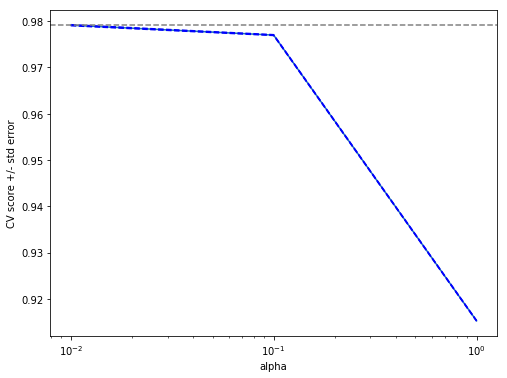

In [150]:
print(lasso_regressor.best_params_)
print(lasso_regressor.best_score_)

preds = lasso_regressor.best_estimator_.predict(X_test)
test_error = mean_squared_error(preds, y_test)
print("Cross-validated Test MSE: ", test_error)



scores = lasso_regressor.cv_results_['mean_test_score']
scores_std = lasso_regressor.cv_results_['std_test_score']
plt.figure().set_size_inches(8, 6)
plt.semilogx(parameters['alpha'], scores)

# plot error lines showing +/- std. errors of the scores
std_error = scores_std / np.sqrt(5)

plt.semilogx(parameters['alpha'], scores + std_error, 'b--')
plt.semilogx(parameters['alpha'], scores - std_error, 'b--')

# alpha=0.2 controls the translucency of the fill color
plt.fill_between(parameters['alpha'], scores + std_error, scores - std_error, alpha=0.2)

plt.ylabel('CV score +/- std error')
plt.xlabel('alpha')
plt.axhline(np.max(scores), linestyle='--', color='.5')

In [169]:
features = X.columns
coefs = lasso_regressor.best_estimator_.coef_

lasso_coef = pd.Series(coefs, index = features)


print("Lasso picked " + str(sum(lasso_coef != 0)) + " variables and eliminated the other " +  str(sum(lasso_coef == 0)) + " variables")

Lasso picked 16 variables and eliminated the other 112 variables


Text(0.5,1,u'Coefficients in the Lasso Model')

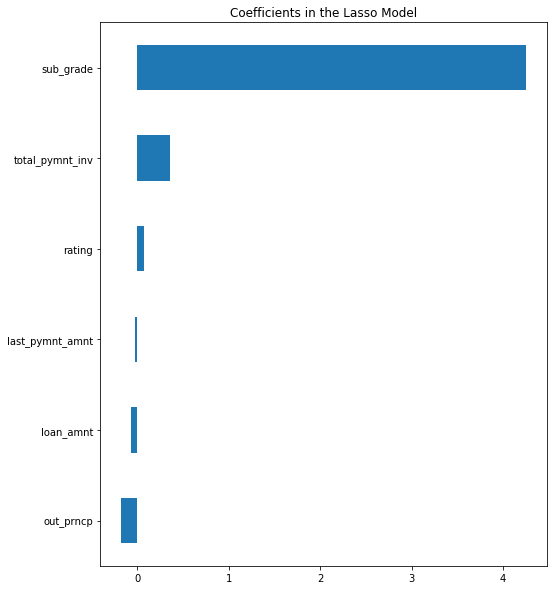

In [170]:
imp_coef = pd.concat([lasso_coef.sort_values().head(3),
                     lasso_coef.sort_values().tail(3)])
plt.rcParams['figure.figsize'] = (8.0, 10.0)
imp_coef.plot(kind = "barh")
plt.title("Coefficients in the Lasso Model")

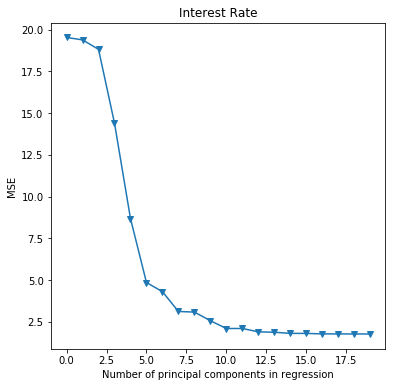

In [161]:
# Principal Components Regression
pca = PCA()

# Scale the data
X_reduced_train = pca.fit_transform(X_train)
n = len(X_reduced_train)

# 10-fold CV, with shuffle
kf_10 = KFold(n_splits=10, shuffle=True, random_state=1)
regr = LinearRegression()
mse = []

# Calculate MSE with only the intercept (no principal components in regression)
score = -1* cross_val_score(regr, np.ones((n,1)), y_train.ravel(), cv=kf_10, scoring='neg_mean_squared_error').mean()    
mse.append(score)

# Calculate MSE using CV for the 19 principle components, adding one component at the time.
for i in np.arange(1, 20):
    score = -1*cross_val_score(regr, X_reduced_train[:,:i], y_train.ravel(), cv=kf_10, scoring='neg_mean_squared_error').mean()
    mse.append(score)

plt.plot(np.array(mse), '-v')
plt.xlabel('Number of principal components in regression')
plt.ylabel('MSE')
plt.title('Interest Rate')
plt.xlim(xmin=-1);

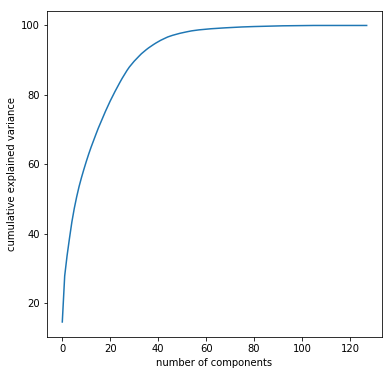

In [164]:
var_components = pd.Series(np.cumsum(np.round(pca.explained_variance_ratio_, decimals=4)*100))

plt.plot(var_components)
plt.xlabel('number of components')
plt.ylabel('cumulative explained variance');

In [181]:
X_reduced_test = pca.transform(X_test)[:,:70]

# Train regression model on training data 
regr = LinearRegression()
regr.fit(X_reduced_train[:,:70], y_train)

# Prediction with test data
pred = regr.predict(X_reduced_test)
mean_squared_error(y_test, pred)

0.41527592173694056

<h4>6. Identifying features pertaining to applicants likely to default</h4>

On the training set, we compute the Pearson correlation, $F$-statistic, and $p$ value of each predictor with the response variable rating (Good loan vs. Bad loan).

In [183]:
X = data.drop(['rating'], axis=1, inplace=False)
y = data.rating

num_cols = X.columns[X.dtypes.apply(lambda c: np.issubdtype(c, np.number))]

scaler = StandardScaler()
X[num_cols] = scaler.fit_transform(X[num_cols])

X = pd.get_dummies(X,drop_first=True)
X.head()

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_length,annual_inc,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,last_pymnt_amnt,collections_12_mths_ex_med,application_type,annual_inc_joint,dti_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_il_6m,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,recovery,public_record,derog,delinq,payment_received,home_ownership_MORTGAGE,home_ownership_NONE,home_ownership_OTHER,home_ownership_OWN,home_ownership_RENT,verification_status_Source Verified,verification_status_Verified,purpose_credit_card,purpose_debt_consolidation,purpose_educational,purpose_home_improvement,purpose_house,purpose_major_purchase,purpose_medical,purpose_moving,purpose_other,purpose_renewable_energy,purpose_small_business,purpose_vacation,purpose_wedding,addr_state_AL,addr_state_AR,addr_state_AZ,addr_state_CA,addr_state_CO,addr_state_CT,addr_state_DC,addr_state_DE,addr_state_FL,addr_state_GA,addr_state_HI,addr_state_IA,addr_state_ID,addr_state_IL,addr_state_IN,addr_state_KS,addr_state_KY,addr_state_LA,addr_state_MA,addr_state_MD,addr_state_ME,addr_state_MI,addr_state_MN,addr_state_MO,addr_state_MS,addr_state_MT,addr_state_NC,addr_state_ND,addr_state_NE,addr_state_NH,addr_state_NJ,addr_state_NM,addr_state_NV,addr_state_NY,addr_state_OH,addr_state_OK,addr_state_OR,addr_state_PA,addr_state_RI,addr_state_SC,addr_state_SD,addr_state_TN,addr_state_TX,addr_state_UT,addr_state_VA,addr_state_VT,addr_state_WA,addr_state_WI,addr_state_WV,addr_state_WY,verification_status_joint_Not Verified,verification_status_joint_Source Verified,verification_status_joint_Verified
1,-1.495350,-1.495272,-1.492791,1.412505,0.457862,-1.578920,0.121528,0.281357,-1.449337,-0.682630,-0.923569,-0.374208,0.165068,4.581053,-1.612234,-0.340706,-0.679102,-1.972965,-1.797503,1.093109,-1.353455,-1.353454,-0.775800,-0.775438,-0.785885,-0.611046,-0.098168,-0.747965,-0.115333,-0.025824,-0.023609,-0.023973,-0.068045,-0.111913,-0.887347,-0.093721,-0.097641,-0.085485,-0.0994,-0.085516,-0.092038,-0.126091,-0.095175,-0.106031,-0.106338,-0.134808,-0.815472,-0.077475,-0.069491,-0.074335,5.110645,-0.440918,-0.607474,-1.002903,0.11837,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,-1.436493,-1.436395,-1.433926,1.412505,-0.125840,-1.546232,-0.638102,-0.332678,-1.194236,0.071436,-0.043584,-0.374208,-0.231209,-0.679075,0.601292,-0.340706,0.448059,-0.075862,1.074127,1.093109,-1.258658,-1.258619,-0.369918,-0.368876,-0.324943,-0.340398,-0.098168,-0.864990,-0.115333,-0.025824,-0.023609,-0.023973,-0.068045,-0.111913,-0.887347,-0.093721,-0.097641,-0.085485,-0.0994,-0.085516,-0.092038,-0.126091,-0.095175,-0.106031,-0.106338,-0.134808,-0.815472,-0.077475,-0.069491,-0.074335,-0.195670,-0.440918,-0.607474,0.997105,0.11837,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,-0.965638,-0.965380,-0.963009,1.412505,0.613968,-1.126177,0.121528,0.434866,0.591475,-0.426187,0.245761,-0.374208,0.957623,0.372951,-0.874392,-0.340706,0.013668,1.275557,-1.206285,1.093109,-1.119937,-1.119841,0.519581,0.522111,0.421679,0.610766,-0.098168,-0.634211,-0.115333,-0.025824,-0.023609,-0.023973,-0.068045,-0.111913,-0.887347,-0.093721,-0.097641,-0.085485,-0.0994,-0.085516,-0.092038,-0.126091,-0.095175,-0.106031,-0.106338,-0.134808,-0.815472,-0.077475,-0.069491,-0.074335,-0.195670,-0.440918,-0.607474,-1.002903,0.11837,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,-1.130437,-1.130235,-1.127

In [185]:
linear_dep = pd.DataFrame()
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=0)

In [186]:
# Pearson correlations
for col in X_train.columns:
    linear_dep.loc[col, 'pearson_corr'] = X_train[col].corr(y_train)
linear_dep['abs_pearson_corr'] = abs(linear_dep['pearson_corr'])

In [188]:
# F-statistics
from sklearn.feature_selection import f_classif
for col in X_train.columns:
    mask = X_train[col].notnull()
    (linear_dep.loc[col, 'F'], linear_dep.loc[col, 'p_value']) = f_classif(pd.DataFrame(X_train.loc[mask, col]), 
                                                                           y_train.loc[mask])

In [189]:
# Sort the results by the absolute value of the Pearson correlation
linear_dep.sort_values('abs_pearson_corr', ascending=False, inplace=True)
linear_dep.drop('abs_pearson_corr', axis=1, inplace=True)

In [190]:
# Reset the index
linear_dep.reset_index(inplace=True)
linear_dep.rename(columns={'index':'variable'}, inplace=True)

In [191]:
linear_dep.head(20)

,variable,pearson_corr,F,p_value
0,recovery,0.586188,262746.661524,0.000000e+00
1,out_prncp,-0.299495,49455.450782,0.000000e+00
2,out_prncp_inv,-0.299489,49453.417762,0.000000e+00
3,int_rate,0.202063,21364.765403,0.000000e+00
4,total_rec_late_fee,0.187997,18388.606943,0.000000e+00
5,sub_grade,0.167703,14524.219512,0.000000e+00
6,grade,0.163778,13833.686288,0.000000e+00
7,initial_list_status,0.143479,10549.528557,0.000000e+00
8,inq_last_6mths,0.116090,6856.511819,0.000000e+00
9,total_rec_int,0.081208,3331.924741,0.000000e+00


In [192]:
linear_dep.tail(20)

,variable,pearson_corr,F,p_value
108,addr_state_MT,-0.002488,3.107166,0.077949
109,addr_state_UT,0.002320,2.701197,0.100274
110,addr_state_KY,-0.002125,2.265599,0.132276
111,addr_state_MD,0.001790,1.607105,0.204900
112,addr_state_PA,-0.001710,1.467743,0.225703
113,addr_state_LA,0.001683,1.422055,0.233066
114,addr_state_OK,0.001656,1.375689,0.240837
115,addr_state_ID,0.001402,0.987145,0.320442
116,addr_state_NM,0.001250,0.784786,0.375682
117,addr_state_OR,-0.001075,0.579958,0.446329


In [194]:
linear_dep[linear_dep['variable'].str.contains("purpose")]

,variable,pearson_corr,F,p_value
15,purpose_small_business,0.054130,1474.927375,3.260833e-322
16,purpose_credit_card,-0.052263,1374.677400,1.713023e-300
24,purpose_wedding,0.036254,660.554458,1.407162e-145
27,purpose_educational,0.033183,553.259080,2.866934e-122
38,purpose_other,0.025377,323.442301,2.715604e-72
51,purpose_house,0.016856,142.644180,7.103823e-33
53,purpose_moving,0.015887,126.712981,2.164314e-29
54,purpose_debt_consolidation,0.014987,112.786948,2.418062e-26
67,purpose_medical,0.009304,43.454478,4.343645e-11
68,purpose_renewable_energy,0.009302,43.428635,4.401384e-11


In [202]:
from sklearn.ensemble import RandomForestClassifier 
## This line instantiates the model. 
rf = RandomForestClassifier() 
## Fit the model on your training data.
rf.fit(X_train, y_train) 
## And score it on your testing data.
rf.score(X_test, y_test)


feature_importances = pd.DataFrame(rf.feature_importances_,
                                   index = X_train.columns, columns=['importance']).sort_values('importance', ascending=False)
 

In [206]:
feature_importances = feature_importances.rename_axis('feature').reset_index()
imp_feat_top15 = feature_importances.iloc[:15]
imp_purpose = feature_importances[feature_importances.feature.str.contains("purpose")].reset_index()

In [207]:
print(imp_feat_top15)
print(imp_purpose)

               feature  importance
0            out_prncp    0.288139
1        out_prncp_inv    0.238331
2             recovery    0.100980
3          tot_cur_bal    0.034212
4   total_rec_late_fee    0.027589
5      total_pymnt_inv    0.015734
6      last_pymnt_amnt    0.015086
7     total_rev_hi_lim    0.015042
8          total_pymnt    0.014878
9      total_rec_prncp    0.014100
10       total_rec_int    0.013792
11                 dti    0.013452
12           revol_bal    0.013430
13          revol_util    0.012941
14          annual_inc    0.012099
    index                     feature  importance
0      34  purpose_debt_consolidation    0.001956
1      40         purpose_credit_card    0.001581
2      46    purpose_home_improvement    0.001031
3      51               purpose_other    0.000894
4      64      purpose_major_purchase    0.000577
5      74      purpose_small_business    0.000430
6      81             purpose_medical    0.000344
7      83              purpose_moving   

<h4>7. Undersampling approach </h4>

We will use two functions, first one creates a confusion matrix and second one provides the repeated undersampling solution for testing models and prints out accuracy, recall and most importantly ROC AUC score.

In [214]:
from sklearn.model_selection import cross_val_score, StratifiedKFold, cross_val_predict, train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis, QuadraticDiscriminantAnalysis
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB, MultinomialNB
from sklearn.metrics import confusion_matrix, precision_recall_curve, auc, roc_auc_score, roc_curve, \
                            recall_score, classification_report, accuracy_score

In [215]:
import itertools

def plot_confusion_matrix(cm, classes):
    plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
    plt.title('Confusion Matrix')
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=0)
    plt.yticks(tick_marks, classes)
    
    ## 
    
    plt.tight_layout()
    plt.xlabel('Predicted label')
    plt.ylabel('True label')

In [216]:
from copy import deepcopy

def cross_validate_repeated_undersampling_full(X, Y, model, n_estimators=1, cv=StratifiedKFold(5,random_state=1)):
    
    preds = []
    true_labels = []
    
    for train_index, test_index in cv.split(X,Y):
        
        X_train, X_test = X.iloc[train_index], X.iloc[test_index]
        y_train, y_test = Y.iloc[train_index], Y.iloc[test_index]
    
        scores = np.zeros((n_estimators,len(y_test)))
        for i in range(n_estimators):
            num1 = len(y_train[y_train==1])
            ind0 = np.random.choice(y_train.index[y_train==0], num1) 
            ind1 = y_train.index[y_train==1] 
            ind_final = np.r_[ind0, ind1]
            X_train_subsample = X_train.loc[ind_final]
            y_train_subsample = y_train.loc[ind_final]

            clf = deepcopy(model)
            print(X_train.shape,y_train.shape)
            clf.fit(X_train, y_train)  
            
            probs = clf.predict_proba(X_test)[:,1]
            scores[i,:] = probs

        preds_final = scores.mean(0) 
        preds.extend(preds_final)
        preds_labels=[round(x) for x in preds]
        
        true_labels.extend(y_test)
        
    cnf_matrix = confusion_matrix(true_labels,preds_labels)
    np.set_printoptions(precision=2)

    print("Accuracy score in the testing dataset: ", accuracy_score(true_labels,preds_labels))
    print("Recall metric in the testing dataset: ", cnf_matrix[1,1]/(cnf_matrix[1,0]+cnf_matrix[1,1]))
        
    class_names = [0,1]
    plt.figure()
    plot_confusion_matrix(cnf_matrix, classes=class_names)
    plt.show()
        
    print("ROC AUC score in the testing dataset: ", roc_auc_score(true_labels,preds))
        
    fpr, tpr, _ = roc_curve(true_labels,preds)
    roc_auc = auc(fpr, tpr)
        
    plt.figure()
    lw = 2
    plt.plot(fpr, tpr, color='darkorange', lw=lw, label='ROC curve (area = %0.2f)' % roc_auc)
    plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic example')
    plt.legend(loc="lower right")
    plt.show()

    return

('Testing:', 'LogisticRegression')
((535366, 128), (535366,))
((535366, 128), (535366,))
((535366, 128), (535366,))
((535366, 128), (535366,))
((535368, 128), (535368,))
('Accuracy score in the testing dataset: ', 0.9465427789267313)
('Recall metric in the testing dataset: ', 0)


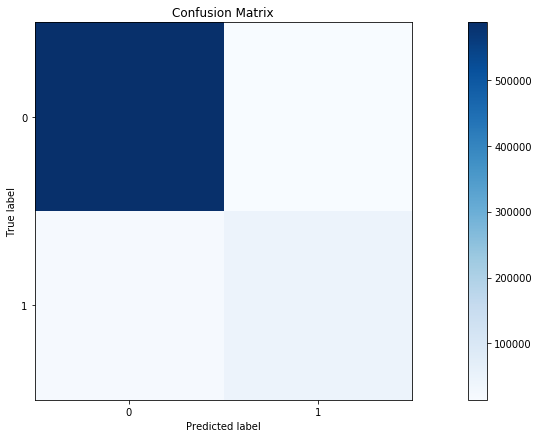

('ROC AUC score in the testing dataset: ', 0.8489671338577919)


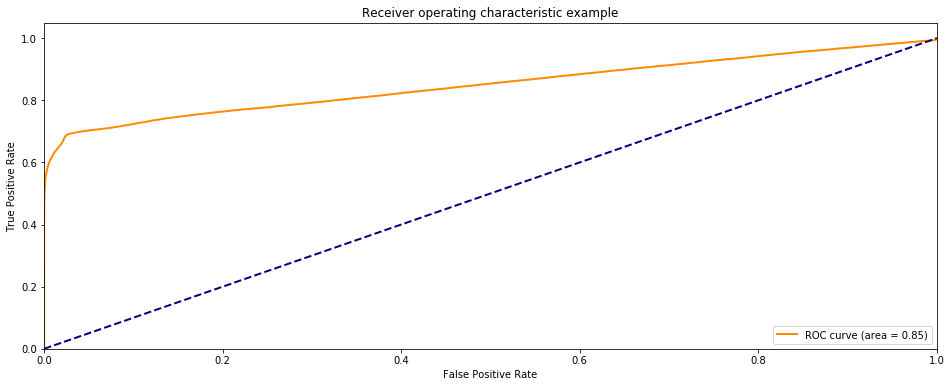

('Testing:', 'RandomForest')
((535366, 128), (535366,))
((535366, 128), (535366,))
((535366, 128), (535366,))
((535366, 128), (535366,))
((535368, 128), (535368,))
('Accuracy score in the testing dataset: ', 0.809093734683387)
('Recall metric in the testing dataset: ', 0)


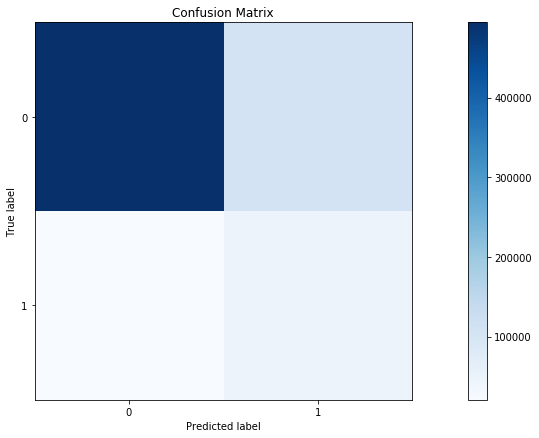

('ROC AUC score in the testing dataset: ', 0.7627546619921184)


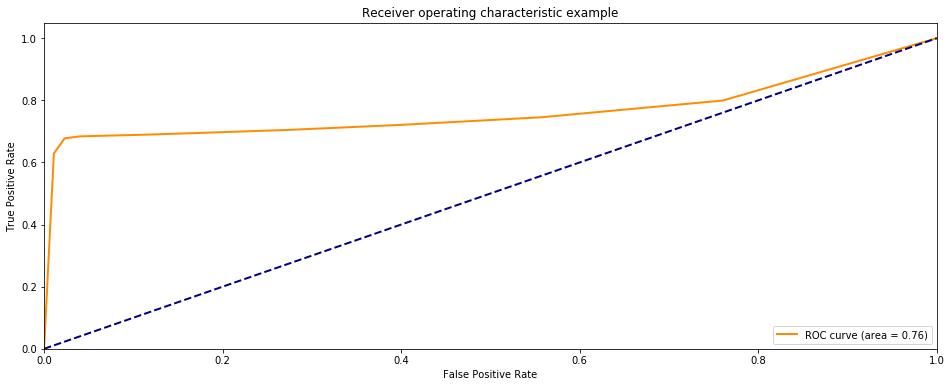

('Testing:', 'NaiveBayes')
((535366, 128), (535366,))
((535366, 128), (535366,))
((535366, 128), (535366,))
((535366, 128), (535366,))
((535368, 128), (535368,))
('Accuracy score in the testing dataset: ', 0.399168868274139)
('Recall metric in the testing dataset: ', 0)


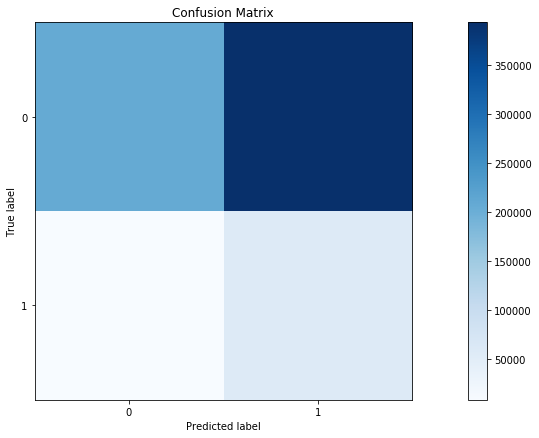

('ROC AUC score in the testing dataset: ', 0.6980960200971118)


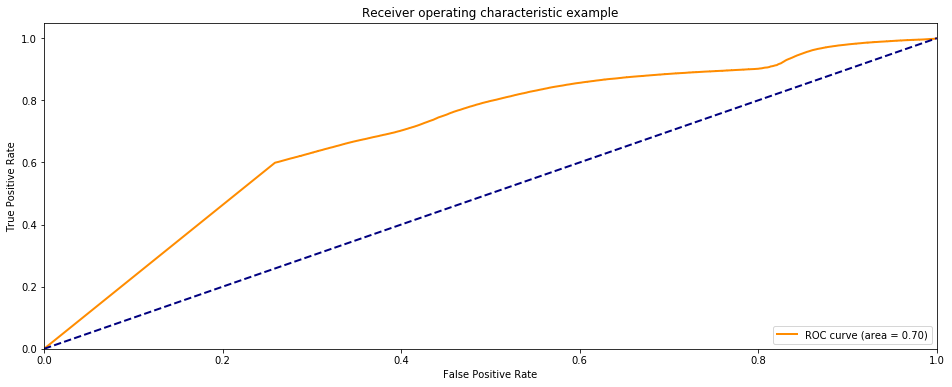

('Testing:', 'LDA')
((535366, 128), (535366,))
((535366, 128), (535366,))
((535366, 128), (535366,))
((535366, 128), (535366,))
((535368, 128), (535368,))
('Accuracy score in the testing dataset: ', 0.9380626053484119)
('Recall metric in the testing dataset: ', 0)


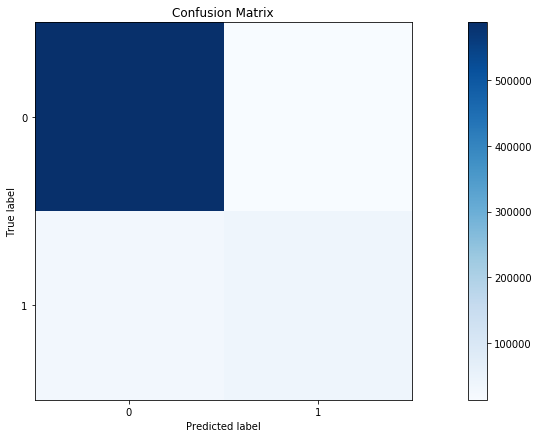

('ROC AUC score in the testing dataset: ', 0.811891459202732)


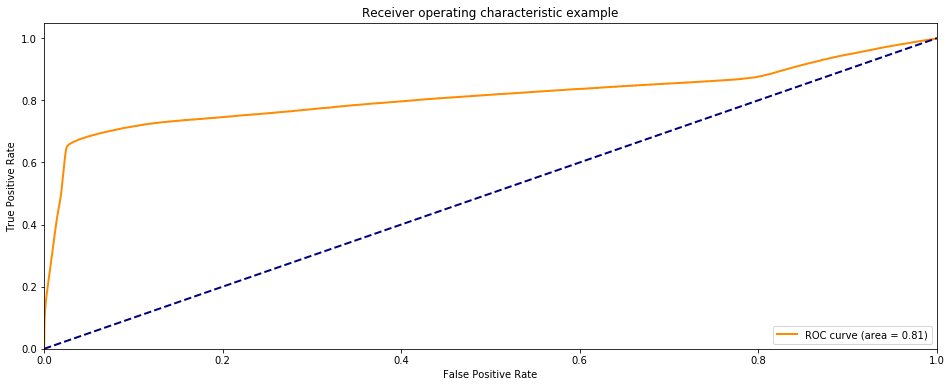

('Testing:', 'QDA')
((535366, 128), (535366,))
((535366, 128), (535366,))
((535366, 128), (535366,))
((535366, 128), (535366,))
((535368, 128), (535368,))
('Accuracy score in the testing dataset: ', 0.3408327455738724)
('Recall metric in the testing dataset: ', 0)


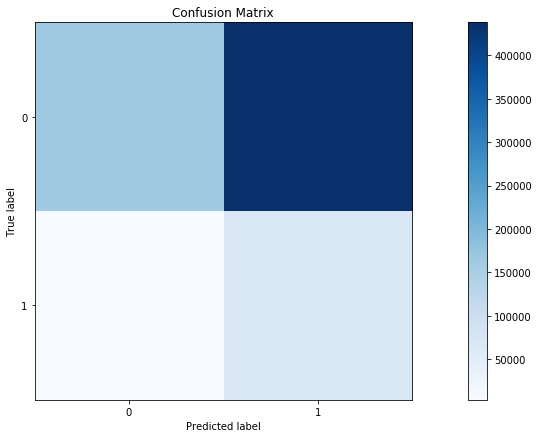

('ROC AUC score in the testing dataset: ', 0.790620170631412)


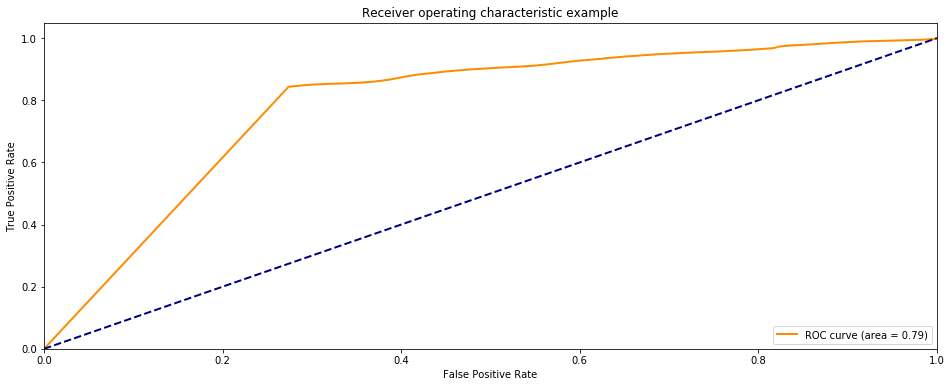

In [217]:
models=[['LogisticRegression',LogisticRegression()],
        ['RandomForest',RandomForestClassifier()],
        ['NaiveBayes',GaussianNB()],
        ['LDA',LinearDiscriminantAnalysis()],
        ['QDA',QuadraticDiscriminantAnalysis()]]

for m in models:
    print ("Testing:", m[0])
    cross_validate_repeated_undersampling_full(X, y, m[1])